In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import ppscore as pps

from collections import Counter
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
import xgboost
from xgboost import plot_importance, XGBClassifier

from src.analyze import Analyzer
from src.model import Model
from src.stats import Stats

C:\Users\micka\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)
C:\Users\micka\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.ensemble.bagging module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.ensemble. Anything that cannot be imported from sklearn.ensemble is now part of the private API.
  warnings.warn(message, FutureWarning)
C:\Users\micka\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.ensemble.base module is  deprecated in version 0.22 and will be removed in

In [2]:
data = pd.read_csv('data.csv', sep = ',', encoding = 'utf8')

In [3]:
analyzer = Analyzer()

In [4]:
data.columns

Index(['Unnamed: 0', '_3_pcts_gross_turnover_6', '_3_pcts_gross_turnover_7',
       '_3_pcts_gross_turnover_3', '_3_pcts_gross_turnover_4',
       '_3_turnover_24months', '_3_average_cart_24months_percentile',
       '_3_pcts_gross_turnover_9', '_3_pcts_gross_turnover_1',
       '_2_pct_frequency_6months', '_2_avg_days_between_orders',
       '_2_pct_frequency_12months', '_2_std_days_between_orders',
       '_2_frequency_24months', '_2_transactional_recency',
       '_1_customer_tenure_months', '_10_target_is_churn'],
      dtype='object')

Let's check what type of data we have. Is there any categorical column ? 

In [5]:
data.rename({"Unnamed: 0": "id"}, axis = 1, inplace =True)

In [6]:
data.dtypes

id                                       int64
_3_pcts_gross_turnover_6               float64
_3_pcts_gross_turnover_7               float64
_3_pcts_gross_turnover_3               float64
_3_pcts_gross_turnover_4               float64
_3_turnover_24months                   float64
_3_average_cart_24months_percentile      int64
_3_pcts_gross_turnover_9               float64
_3_pcts_gross_turnover_1               float64
_2_pct_frequency_6months               float64
_2_avg_days_between_orders             float64
_2_pct_frequency_12months              float64
_2_std_days_between_orders             float64
_2_frequency_24months                    int64
_2_transactional_recency                 int64
_1_customer_tenure_months                int64
_10_target_is_churn                      int64
dtype: object

_2_avg_days_between_orders dtype seems to be float, lets check distribution and put it in integer otherwise

In [7]:
print(data._2_avg_days_between_orders.value_counts())
data['_2_avg_days_between_orders'] = data['_2_avg_days_between_orders'].astype(np.int64)

14.0     2679
17.0     2649
16.0     2630
18.0     2582
15.0     2561
         ... 
590.0       1
423.0       1
467.0       1
625.0       1
542.0       1
Name: _2_avg_days_between_orders, Length: 580, dtype: int64


Let's look for missing datas now

In [8]:
data.isnull().sum()

id                                     0
_3_pcts_gross_turnover_6               0
_3_pcts_gross_turnover_7               0
_3_pcts_gross_turnover_3               0
_3_pcts_gross_turnover_4               0
_3_turnover_24months                   0
_3_average_cart_24months_percentile    0
_3_pcts_gross_turnover_9               0
_3_pcts_gross_turnover_1               0
_2_pct_frequency_6months               0
_2_avg_days_between_orders             0
_2_pct_frequency_12months              0
_2_std_days_between_orders             0
_2_frequency_24months                  0
_2_transactional_recency               0
_1_customer_tenure_months              0
_10_target_is_churn                    0
dtype: int64

Seems like we do not have missing values here. How lucky ! Let's start plotting datas

Let's start by vizualizing the Churn proportion in this sample

In [9]:
analyzer.get_pie_chart(data = data,
                       name ='_10_target_is_churn', 
                       title= 'Churn Proportion')

The first thing to notice here is that our target variable is unbalanced. which means we have a much larger proportion of one specific class over another.
The churn rate is only about 10% of the dataset in this sample. We will need some techniques to bypass this situation.

In [10]:
churn_map = {0: "No", 1:"Yes"}
data['Churn'] = data['_10_target_is_churn'].map(churn_map)

Let's now look at tenure depending on the churn

In [11]:
print(data.groupby('Churn')._1_customer_tenure_months.describe().round(0))
analyzer.get_boxplot(data=data, name = '_1_customer_tenure_months', target = 'Churn', title = "Churn x Tenure")

         count  mean   std   min   25%   50%   75%    max
Churn                                                    
No     90272.0  76.0  47.0  24.0  39.0  63.0  99.0  249.0
Yes    10631.0  53.0  33.0  24.0  32.0  36.0  65.0  241.0


Big differences between positive and negative churn. 
Seems like people who stay customer are long time period customer already.
This will definitely be a good feature for our model. Let's check the churn percentage by tenure year

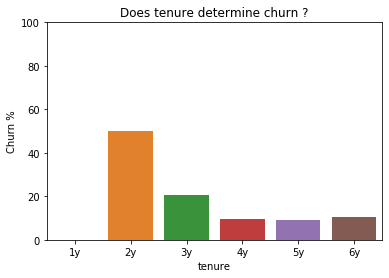

In [12]:
bins = [0, 12, 24, 36, 48, 60, 72]
labels = ['1y', '2y', '3y', '4y', '5y', '6y']

data['tenure'] = pd.cut(data['_1_customer_tenure_months'], bins, labels = labels)

analyzer.get_barplot(data = data, name = 'tenure', target = data._10_target_is_churn*100,  title = 'Does tenure determine churn ?', ylabel = 'Churn %')

the more the years passed, the more the customers stay. 2nd year does not give enough information as we only have two elements. Lets check this 3rd year gap with something else ? 

In [13]:
data['_3_average_cart_24months_percentile'].value_counts()

89     1102
24     1083
41     1073
44     1071
76     1066
       ... 
58      941
22      941
54      937
0       521
100     486
Name: _3_average_cart_24months_percentile, Length: 101, dtype: int64


Among the users whom dont go to leroy merlin anymore.  Half of them are doing so after a period of 3 years. 

It could be interesting to display how many commands they pass during these 3 years. And how many after that. 
Is there a lot of changing ? How many in the first year. It could be interesting to have access to all of their purchases, did they come a lot of time in a short period of time ? 

In [14]:
len(set(data['_3_average_cart_24months_percentile']))

101

In [15]:
print(max(data['_3_average_cart_24months_percentile']), min(data['_3_average_cart_24months_percentile']))

100 0


Technically speaking, there are no 0th or 100th percentile. Being on the 100th would mean an average cart bigger than infinity customers which is not possible in reality 
The same goes for 0th percentile since having empty cart would mean a customer who does not buy anything.

Still, we are gonna include these datas in the the next steps

In [16]:
print(data.groupby('Churn')._2_frequency_24months.describe().round(0))
analyzer.get_boxplot(data=data, name = '_2_frequency_24months', target = 'Churn', title = "Churn x Purchases 24 Months")

         count  mean   std  min   25%   50%   75%    max
Churn                                                   
No     90272.0  34.0  31.0  2.0  14.0  25.0  43.0  565.0
Yes    10631.0  10.0  12.0  2.0   4.0   7.0  13.0  234.0


Whose whom don't go anymore in store are the ones with fewer purchases in the last 2 years. This can be explained either by the fact they do not need to make more purchases or that they were not really satisfied with the bought products. 

Is this pattern still true with other periods ? 

In [17]:
print(data.groupby('Churn')._2_pct_frequency_12months.describe().round(0))
analyzer.get_boxplot(data=data, name = '_2_pct_frequency_12months', target = 'Churn', title = "Churn x Perc Purchases 12 Months")

         count  mean  std  min  25%  50%  75%  max
Churn                                             
No     90272.0   0.0  0.0  0.0  0.0  0.0  1.0  1.0
Yes    10631.0   0.0  0.0  0.0  0.0  0.0  0.0  1.0


The column may be in percentage, we still can see that "regular" customers buys more often. Actually, the top 75% of regular customers buys more often than half the customer with churn. This confirms that customer retention means increasing the revenues. 

In [18]:
print(data.groupby('Churn')._2_pct_frequency_6months.describe().round(0))
analyzer.get_boxplot(data=data, name = '_2_pct_frequency_6months', target = 'Churn', title = "Churn x Perc Purchases 6 Months")

         count  mean  std  min  25%  50%  75%  max
Churn                                             
No     90272.0   0.0  0.0  0.0  0.0  0.0  0.0  1.0
Yes    10631.0   0.0  0.0  0.0  0.0  0.0  0.0  1.0


Even if huge amount of outliers. The trend is confirmed in last 6 months. Regular customers orders more than the others. 
Lets check now the average cart. Maybe some of people whom dont come again is because they got all they need. Does people who still comes have smaller baskets but more regular ? 

In [19]:
print(data.groupby('Churn')._2_transactional_recency.describe().round(0))

analyzer.get_boxplot(data=data, name = '_2_transactional_recency', target = 'Churn', title = "Churn x Transactional recency")

         count   mean    std  min   25%    50%    75%    max
Churn                                                       
No     90272.0   60.0   85.0  1.0  11.0   28.0   73.0  720.0
Yes    10631.0  220.0  179.0  1.0  73.0  171.0  330.0  727.0


Huge differences. Seems like customers who churn have much more recency. With tenure, it seems like we found a pretty good feature to predict churn.

In [20]:
print(data.groupby('Churn')._2_avg_days_between_orders.describe().round(0))
analyzer.get_boxplot(data=data, name = '_2_avg_days_between_orders', target = 'Churn', title = "Churn x Avg Days Between 2 Orders")

         count  mean   std  min   25%   50%   75%    max
Churn                                                   
No     90272.0  37.0  42.0  1.0  16.0  26.0  44.0  691.0
Yes    10631.0  82.0  85.0  1.0  32.0  57.0  98.0  710.0


1 month difference. Regular or loyal customers come in average once a month. 25% of Others come also almost once a month. More than a half comes 1 month out of 2 in best scenario. If they actually come 1 month out of 2, it would be interesting to do a investigate further why. What products do they actually buy ? Is the rival company selling this kind of product too ? Where is it the cheapest ?  

In [21]:
print(data.groupby('Churn')._2_std_days_between_orders.describe().round(0))
analyzer.get_boxplot(data=data, name = '_2_std_days_between_orders', target = 'Churn', title = "Churn x Std Days Between 2 Orders")

         count  mean   std  min   25%   50%   75%    max
Churn                                                   
No     90272.0  40.0  37.0  0.0  18.0  30.0  50.0  510.0
Yes    10631.0  66.0  61.0  0.0  25.0  52.0  89.0  484.0


Huge amount of outliers again. Even the std is pretty large. We do not have information on what customer who leave orders. But we have 
access to information on some rayons. Can we see something by looking at the gross user turnover ? 

In [22]:
data.columns

Index(['id', '_3_pcts_gross_turnover_6', '_3_pcts_gross_turnover_7',
       '_3_pcts_gross_turnover_3', '_3_pcts_gross_turnover_4',
       '_3_turnover_24months', '_3_average_cart_24months_percentile',
       '_3_pcts_gross_turnover_9', '_3_pcts_gross_turnover_1',
       '_2_pct_frequency_6months', '_2_avg_days_between_orders',
       '_2_pct_frequency_12months', '_2_std_days_between_orders',
       '_2_frequency_24months', '_2_transactional_recency',
       '_1_customer_tenure_months', '_10_target_is_churn', 'Churn', 'tenure'],
      dtype='object')

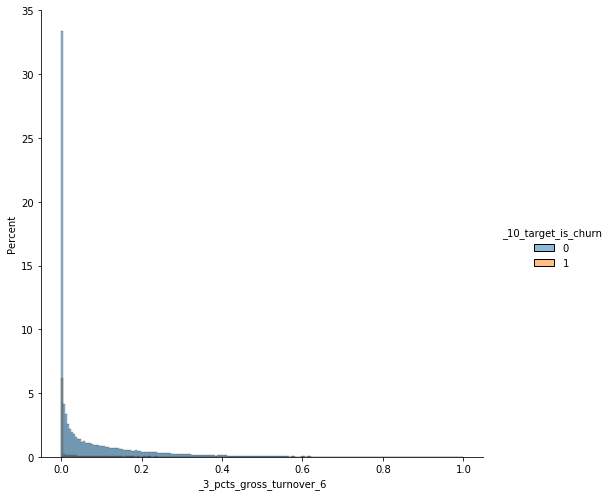

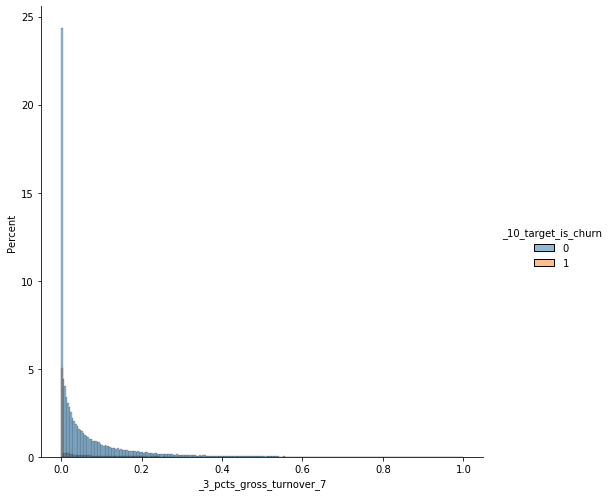

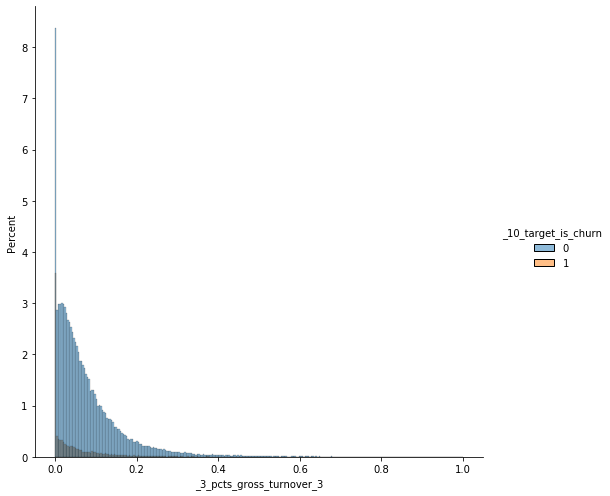

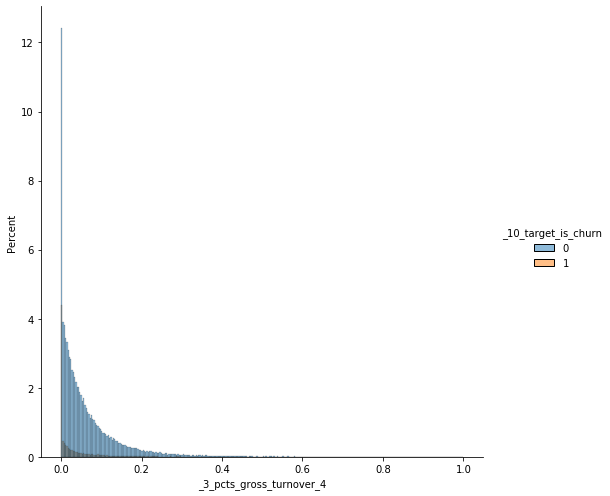

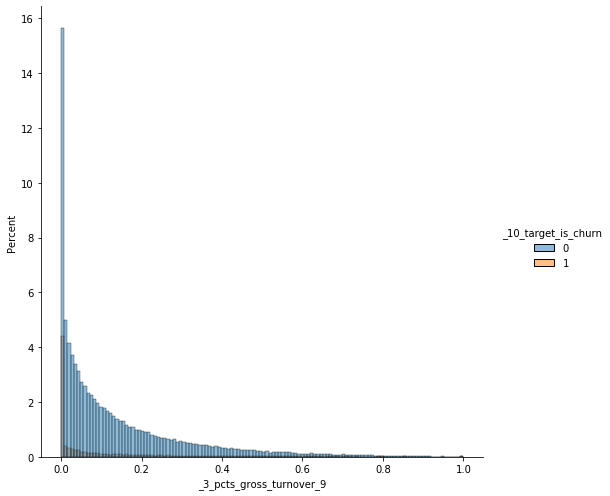

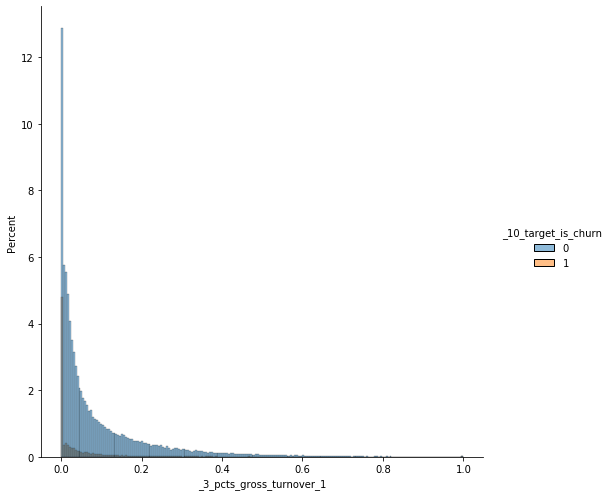

In [23]:
gross_col = ["_3_pcts_gross_turnover_6", "_3_pcts_gross_turnover_7", "_3_pcts_gross_turnover_3", "_3_pcts_gross_turnover_4",
            "_3_pcts_gross_turnover_9", "_3_pcts_gross_turnover_1"]

for col in gross_col:
    analyzer.get_displot(data = data, name = col, stat = 'percent', hue = '_10_target_is_churn', height = 7)

Seems like rayon 1, 3 and 9 are the favourites of customers. 6 and 7 are the less favourites in this sample. 
Especially for customers who leave, 1 and 3 seem to be major rayon, which items are contained is these.  
Maybe an analysis by item could tell us if they are key items.

Just by looking at these graphs, we can tell that rayon 6 and 7 are not important for people who leaves. Or worse, they buy theses items at a rival. 



In [24]:
print(data.groupby('Churn')._3_pcts_gross_turnover_3.describe().round(0))

analyzer.get_boxplot(data=data, name = '_3_pcts_gross_turnover_3', target = 'Churn', title = "Churn x Perc Gross Turnover")

         count  mean  std  min  25%  50%  75%  max
Churn                                             
No     90272.0   0.0  0.0  0.0  0.0  0.0  0.0  1.0
Yes    10631.0   0.0  0.0  0.0  0.0  0.0  0.0  1.0


No surprise here, the revenues are higher with people that remains customers.

# Feature Engineering

Now that we know more abut this dataset. Let's try to build some machine learning and try to predict churn with it.

In [25]:
data.describe()

,id,_3_pcts_gross_turnover_6,_3_pcts_gross_turnover_7,_3_pcts_gross_turnover_3,_3_pcts_gross_turnover_4,_3_turnover_24months,_3_average_cart_24months_percentile,_3_pcts_gross_turnover_9,_3_pcts_gross_turnover_1,_2_pct_frequency_6months,_2_avg_days_between_orders,_2_pct_frequency_12months,_2_std_days_between_orders,_2_frequency_24months,_2_transactional_recency,_1_customer_tenure_months,_10_target_is_churn
count,1.009030e+05,100903.000000,100903.000000,100903.000000,100903.000000,1.009030e+05,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000
mean,6.296223e+05,0.084013,0.071773,0.078608,0.064923,1.061452e+04,49.990000,0.140680,0.093975,0.226230,42.074448,0.460427,43.153954,31.072624,77.128628,73.582104,0.105359
std,3.636123e+05,0.134662,0.115180,0.094288,0.089678,7.848123e+04,28.890177,0.174095,0.133020,0.161224,50.022470,0.200095,40.581866,30.387805,110.822171,46.664634,0.307016
min,3.000000e+00,0.000000,0.000000,0.000000,0.000000,-6.510140e+03,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,2.000000,1.000000,24.000000,0.000000
25%,3.146235e+05,0.000000,0.000000,0.018223,0.009350,1.102905e+03,25.000000,0.015096,0.010584,0.117647,16.000000,0.333333,18.556825,12.000000,12.000000,36.000000,0.000000
50%,6.304710e+05,0.019449,0.025586,0.050433,0.035268,2.560720e+03,50.000000,0.074330,0.039467,0.210526,28.000000,0.466667,31.559934,23.000000,34.000000,59.000000,0.000000
75%,9.434470e+05,0.116259,0.090155,0.104254,0.084397,5.975730e+03,75.000000,0.200342,0.123555,0.310345,48.000000,0.583333,53.609357,40.000000,92.000000,96.000000,0.000000
max,1.261286e+06,1.000000,1.000000,1.000000,1.000000,7.332964e+06,100.000000,1.000000,1.000000,1.000000,710.000000,1.000000,509.823989,565.000000,727.000000,249.000000,1.000000


Some datas are percentage, some are inteer number, we have both large intraclass variance and interclass variance. 
Let's apply min max normalization to reduce that. 

In [26]:
# instantiate stats class to get access to stats functions
stats = Stats()

In [27]:
basic_stats = {"variances":[], "min_values":[], "max_values":[]}

for col in data.drop(['id', 'Churn', '_10_target_is_churn','tenure'], axis = 1).columns:
    basic_stats["variances"].append(stats.get_variance(data, col))
    basic_stats["min_values"].append(stats.get_min(data, col))
    basic_stats["max_values"].append(stats.get_max(data, col))


In [28]:
print(basic_stats['variances'], '\n',
     basic_stats['min_values'], '\n',
    basic_stats['max_values'])

[0.01813371604512642, 0.013266404220371215, 0.00889008894408618, 0.008042093170071776, 6159242561.343581, 834.6340635089363, 0.030308686726279885, 0.017694172958758574, 0.02599276178671532, 2502.2227361784953, 0.040037487220720785, 1646.8715469517342, 923.4095498632324, 12281.431925026138, 2177.566529862391] 
 [0.0, 0.0, 0.0, 0.0, -6510.14, 0, 0.0, 0.0, 0.0, 1, 0.0, 0.0, 2, 1, 24] 
 [1.0, 1.0, 1.0, 1.0, 7332963.98, 100, 1.0, 1.0, 1.0, 710, 1.0, 509.8239892355008, 565, 727, 249]


In [29]:
cols_to_norm = ['_3_turnover_24months', '_3_average_cart_24months_percentile', '_2_avg_days_between_orders', '_2_std_days_between_orders',
                '_2_frequency_24months', '_2_transactional_recency', '_1_customer_tenure_months']

data = stats.normalize(data, cols_to_norm)

In [30]:
data.describe()

,id,_3_pcts_gross_turnover_6,_3_pcts_gross_turnover_7,_3_pcts_gross_turnover_3,_3_pcts_gross_turnover_4,_3_turnover_24months,_3_average_cart_24months_percentile,_3_pcts_gross_turnover_9,_3_pcts_gross_turnover_1,_2_pct_frequency_6months,_2_avg_days_between_orders,_2_pct_frequency_12months,_2_std_days_between_orders,_2_frequency_24months,_2_transactional_recency,_1_customer_tenure_months,_10_target_is_churn
count,1.009030e+05,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000,100903.000000
mean,6.296223e+05,0.084013,0.071773,0.078608,0.064923,0.002333,0.499900,0.140680,0.093975,0.226230,0.057933,0.460427,0.084645,0.051639,0.104860,0.220365,0.105359
std,3.636123e+05,0.134662,0.115180,0.094288,0.089678,0.010693,0.288902,0.174095,0.133020,0.161224,0.070554,0.200095,0.079600,0.053975,0.152648,0.207398,0.307016
min,3.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.146235e+05,0.000000,0.000000,0.018223,0.009350,0.001037,0.250000,0.015096,0.010584,0.117647,0.021157,0.333333,0.036398,0.017762,0.015152,0.053333,0.000000
50%,6.304710e+05,0.019449,0.025586,0.050433,0.035268,0.001236,0.500000,0.074330,0.039467,0.210526,0.038082,0.466667,0.061904,0.037300,0.045455,0.155556,0.000000
75%,9.434470e+05,0.116259,0.090155,0.104254,0.084397,0.001701,0.750000,0.200342,0.123555,0.310345,0.066291,0.583333,0.105153,0.067496,0.125344,0.320000,0.000000
max,1.261286e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


Much better now. Let's be careful later with bias/variance dilemma. 

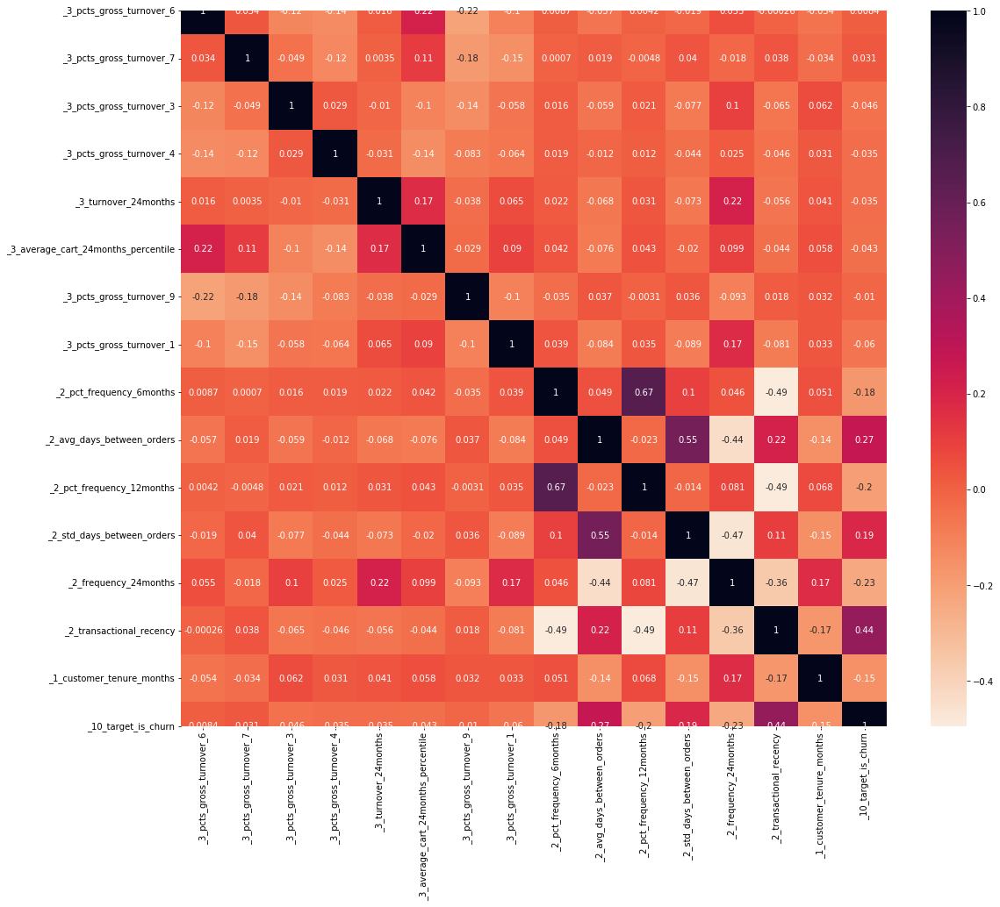

In [31]:
plt.figure(figsize = (18,15))
sns.heatmap(data.drop(['id', 'Churn', 'tenure'], axis = 1).corr(), cmap = "rocket_r", annot = True)

As expected, transactional_recency and avg_days_between_orders are among the more correlated features with churn. 
Surprisingly, tenure is not. Is this because of min max normalization ?

Let's check now the predictive power of these features

In [32]:
tmp_data = data.drop(['id', 'tenure', '_10_target_is_churn'], axis = 1)
#pred_power_sc = [pps.score(tmp_data, col, '_10_target_is_churn') for col in tmp_data.columns]

pred_power_sc = pps.predictors(tmp_data, 'Churn')

In [33]:
pred_power_sc

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
0,_2_pct_frequency_12months,Churn,2.034682e-01,classification,True,weighted F1,0.839353,0.872040,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
1,_2_frequency_24months,Churn,1.949142e-01,classification,True,weighted F1,0.839353,0.870666,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
2,_2_transactional_recency,Churn,1.609869e-01,classification,True,weighted F1,0.839353,0.865215,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
3,_2_avg_days_between_orders,Churn,1.095531e-01,classification,True,weighted F1,0.839353,0.856953,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
4,_3_average_cart_24months_percentile,Churn,2.946738e-07,classification,True,weighted F1,0.839353,0.839353,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
5,_3_pcts_gross_turnover_6,Churn,0.000000e+00,classification,True,weighted F1,0.839353,0.824493,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
6,_3_pcts_gross_turnover_7,Churn,0.000000e+00,classification,True,weighted F1,0.839353,0.820793,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
7,_3_pcts_gross_turnover_3,Churn,0.000000e+00,classification,True,weighted F1,0.839353,0.815035,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
8,_3_pcts_gross_turnover_4,Churn,0.000000e+00,classification,True,weighted F1,0.839353,0.820656,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."
9,_3_turnover_24months,Churn,0.000000e+00,classification,True,weighted F1,0.839353,0.834872,"DecisionTreeClassifier(ccp_alpha=0.0, class_we..."


Seems like features with the more predictive power are : 
    
    -percentage number of order made by the customer the last year
    -actual number of orders made the last 2 years
    -the transactional recency
    -the average days between orders
    
Let's now split our data in train,validation and test set, perform gridsearch with 5 folds and test our model

In [34]:
ids,target = data['id'], data['_10_target_is_churn']

data.drop(['_10_target_is_churn', 'id', 'Churn', 'tenure'], axis = 1, inplace = True)


Instantiate model class

In [35]:
my_model = Model(data, target)

Create train,valid, test with 80/20/20 ratio

In [36]:
my_model.create_train_test_split(test_size = 0.2, random_state = 12)

Create pipeline which apply oversampling Smote, before using XGB classifier

In [37]:
my_model.create_pipeline()

Creation of our hyperparameters grid for tuning. Here we use a minimal amount of values to avoid too much computational time

In [38]:
eta_range = [3e-3, 3e-1]
depth_range = [4,5]
l2_range = [1e-2, 1e-1]
l1_range = [1e-2, 1e-1]
neighbors = [7,11]

# did not vary the number of trees to gain some computation time
param_grid = {"classifier__eta": eta_range,
             "classifier__max_depth": depth_range,
             "classifier__lambda": l2_range,
             "classifier__alpha": l1_range,
             "sampling__k_neighbors":neighbors}

In [39]:
my_model.run_grid_search_cv(param_grid)

C:\Users\micka\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.



In [49]:
# Print the best parameters and the corresponding mean cross-validation score
print("Best parameters: ", my_model.grid_search.best_params_)
print("Best score: ", my_model.grid_search.best_score_)

Best parameters:  {'classifier__alpha': 0.1, 'classifier__eta': 0.3, 'classifier__lambda': 0.1, 'classifier__max_depth': 4, 'sampling__k_neighbors': 11}
Best score:  0.4655286440906707


In [50]:
my_model.grid_search

GridSearchCV(cv=5, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('sampling',
                                        SMOTE(k_neighbors=5, kind='deprecated',
                                              m_neighbors='deprecated',
                                              n_jobs=1, out_step='deprecated',
                                              random_state=None, ratio=None,
                                              sampling_strategy='auto',
                                              svm_estimator='deprecated')),
                                       ('classifier',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      colsample_bylevel=None,
                                                      colsample...
                                                      tree_method=None,
 

In [55]:
X_test, y_test = my_model.get_test_set()
y_pred = my_model.grid_search.predict(X_test.values)

In [60]:
confusion_matrix(y_test, y_pred)

array([[16925,  1091],
       [ 1185,   980]], dtype=int64)

In [61]:
def sensitivity(tp, fn):
    return 100*(tp/(tp+fn))

def specificity(tn, fp):
    return(100*(tn/(tn+fp)))

def vpp(tp, fp):
    return(100*(tp/(tp+fp)))

def get_macro_thresh(pred,labels):
    macro_results = {"val":[], "sensitivity":[], "vpp":[]}
    
    #get every tenth from 0 to 1
    values = np.linspace(0,1,10, endpoint = False)
    
    
    #for each thresh, let's compute sensitivity and vpp and put it in dataframe.
    for val in values:
        tmp_pred = [1 if x > val else 0 for x in pred]
        tn,fp,fn,tp = confusion_matrix(labels, tmp_pred).ravel()
        
        macro_results["val"].append(val)
        macro_results["sensitivity"].append(sensitivity(tp, fn))
        macro_results["vpp"].append(vpp(tp,fp))
        
    return pd.DataFrame(macro_results)
    

In [62]:
results = get_macro_thresh(y_pred, y_test)

In [63]:
results

,val,sensitivity,vpp
0,0.0,45.265589,47.320135
1,0.1,45.265589,47.320135
2,0.2,45.265589,47.320135
3,0.3,45.265589,47.320135
4,0.4,45.265589,47.320135
5,0.5,45.265589,47.320135
6,0.6,45.265589,47.320135
7,0.7,45.265589,47.320135
8,0.8,45.265589,47.320135
9,0.9,45.265589,47.320135


In [94]:
X_train, y_train = my_model.get_train_set()

In [95]:
X_train, y_train = SMOTE(k_neighbors=7).fit_resample(X_train, y_train)

C:\Users\micka\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.



In [96]:
XGBClassifier()

XGBClassifier(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=None, gamma=None,
              gpu_id=None, importance_type='gain', interaction_constraints=None,
              learning_rate=None, max_delta_step=None, max_depth=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='binary:logistic', random_state=None, reg_alpha=None,
              reg_lambda=None, scale_pos_weight=None, subsample=None,
              tree_method=None, validate_parameters=False, verbosity=None)

In [97]:
final_model = XGBClassifier(reg_alpha = 0.1,
                           learning_rate = 0.3,
                           reg_lambda = 0.1,
                           max_depth = 4,
                           n_estimators = 1000)

final_model.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster=None, colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              learning_rate=0.3, max_delta_step=0, max_depth=4,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=1000, n_jobs=0, num_parallel_tree=1,
              objective='binary:logistic', random_state=0, reg_alpha=0.1,
              reg_lambda=0.1, scale_pos_weight=1, subsample=1, tree_method=None,
              validate_parameters=False, verbosity=None)

In [93]:
final_model

XGBClassifier(base_score=0.5, booster=None, colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              learning_rate=0.3, max_delta_step=0, max_depth=4,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              n_estimators=1000, n_jobs=0, num_parallel_tree=1,
              objective='binary:logistic', random_state=0, reg_alpha=0.1,
              reg_lambda=0.1, scale_pos_weight=1, subsample=1, tree_method=None,
              validate_parameters=False, verbosity=None)

In [101]:
X_valid, y_valid = my_model.get_valid_set()
pred_valid = final_model.predict(X_valid.values)
results_valid = get_macro_thresh(pred_valid, y_valid)

In [102]:
results_valid

,val,sensitivity,vpp
0,0.0,35.096835,50.995196
1,0.1,35.096835,50.995196
2,0.2,35.096835,50.995196
3,0.3,35.096835,50.995196
4,0.4,35.096835,50.995196
5,0.5,35.096835,50.995196
6,0.6,35.096835,50.995196
7,0.7,35.096835,50.995196
8,0.8,35.096835,50.995196
9,0.9,35.096835,50.995196


In [98]:
y_pred = final_model.predict(X_test.values)
results = get_macro_thresh(y_pred, y_test.values)

In [100]:
results

,val,sensitivity,vpp
0,0.0,35.103926,51.630435
1,0.1,35.103926,51.630435
2,0.2,35.103926,51.630435
3,0.3,35.103926,51.630435
4,0.4,35.103926,51.630435
5,0.5,35.103926,51.630435
6,0.6,35.103926,51.630435
7,0.7,35.103926,51.630435
8,0.8,35.103926,51.630435
9,0.9,35.103926,51.630435


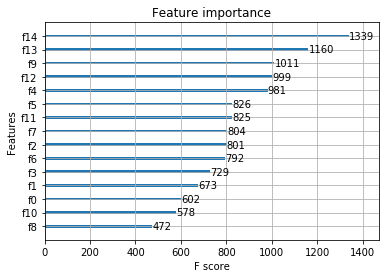

<Figure size 1152x864 with 0 Axes>

In [103]:
xgboost.plot_importance(final_model)
plt.figure(figsize = (16,12))
plt.show()

In [107]:
X_train,_ = my_model.get_train_set()
for index, col in enumerate(X_train.columns):
    print(index, col)

0 _3_pcts_gross_turnover_6
1 _3_pcts_gross_turnover_7
2 _3_pcts_gross_turnover_3
3 _3_pcts_gross_turnover_4
4 _3_turnover_24months
5 _3_average_cart_24months_percentile
6 _3_pcts_gross_turnover_9
7 _3_pcts_gross_turnover_1
8 _2_pct_frequency_6months
9 _2_avg_days_between_orders
10 _2_pct_frequency_12months
11 _2_std_days_between_orders
12 _2_frequency_24months
13 _2_transactional_recency
14 _1_customer_tenure_months


After performing simple crossvalidation training and not include all hyperparameters that can be tune. We can see that the features with the most ppscore are the one with best importance for explaining xgb predictions

A lot can be done to improve these results : 
    
    -Add more datas
        -Replace some of the features. Does the actual average cart, and min/max cart per customer adds informations ? 
        -More information of each rayon turnover
        -Mean time for a customer to go to the store ? Is there a rival on the way ? 
    -Make a complete crossvalidation with all parameters. Compare with or without Smote, does that change anything ? 
    -Try some other ML algorithms and doing some Voting Classifier ? 
    -In the case we add more features, maybe trying PCA (FCA or MCA) to reduce dimensionality and study the inertia of features.
    -Due to the amount of datas, a Neural Network could be used to improve results. However, we would certainly lose a part of explainability, which is vital is marketing world. Maybe by doing some research of explainable neural networks.
    
    
